In [1]:
import matplotlib.pyplot as plt
import pandas as pd
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

Animation size has reached 20992869 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


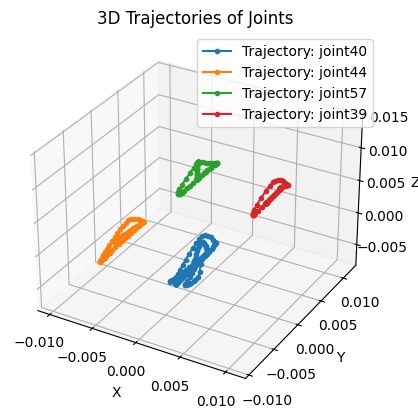

In [ ]:

input_file = "A:/Yo/2-Universidad/MIT/PANDA/3D/coords_animation/foot_trajectory.csv"
data = pd.read_csv(input_file)


fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')


max_range = max(
    data['X'].max() - data['X'].min(),
    data['Y'].max() - data['Y'].min(),
    data['Z'].max() - data['Z'].min()
) / 2.0
mid_x = (data['X'].max() + data['X'].min()) * 0.5
mid_y = (data['Y'].max() + data['Y'].min()) * 0.5
mid_z = (data['Z'].max() + data['Z'].min()) * 0.5

ax.set_xlim(mid_x - max_range, mid_x + max_range)
ax.set_ylim(mid_y - max_range, mid_y + max_range)
ax.set_zlim(mid_z - max_range, mid_z + max_range)

ax.set_title("3D Trajectories of Joints")
ax.set_xlabel("X")
ax.set_ylabel("Y")
ax.set_zlabel("Z")

# Get joints list
joints = data['JOINT_NUM'].unique()

# Initialize the plot elements
lines = {joint: ax.plot([], [], [], marker='o', markersize=3, label=f'Trajectory: {joint}')[0] for joint in joints}

# Animation update function
def update(frame):
    for joint in joints:
        joint_data = data[(data['JOINT_NUM'] == joint) & (data['FRAME'] <= frame)]
        lines[joint].set_data(joint_data['X'], joint_data['Y'])
        lines[joint].set_3d_properties(joint_data['Z'])
    return lines.values()

ani = FuncAnimation(fig, update, frames=range(data['FRAME'].min(), data['FRAME'].max() + 1), blit=False, interval=50)

ax.legend()


HTML_animation = HTML(ani.to_jshtml())
HTML_animation